<a href="https://colab.research.google.com/github/HHH023/coastline_extraction/blob/main/cnn_seg.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Coastline segmentation**

Train a classifier

In [1]:
!unzip -uq '/content/drive/MyDrive/train_zip/sea.zip' -d '/content/sea_land_total/sea'
!unzip -uq '/content/drive/MyDrive/train_zip/land.zip' -d '/content/sea_land_total/land'
!unzip -uq '/content/drive/MyDrive/test_zip/sea.zip' -d '/content/sea_land_total/sea'
!unzip -uq '/content/drive/MyDrive/test_zip/land.zip' -d '/content/sea_land_total/land'

In [2]:
import os
import random
import math
import shutil

def data_split(old_path):
    new_path = 'data'
    if os.path.exists('data') == 0:
        os.makedirs(new_path)
    for root_dir, sub_dirs, file in os.walk(old_path):                               # 遍历os.walk(）返回的每一个三元组，内容分别放在三个变量中
        for sub_dir in sub_dirs:
            file_names = os.listdir(os.path.join(root_dir, sub_dir))                 # 遍历每个次级目录
            file_names = list(filter(lambda x: x.endswith('.jpg'), file_names))      # 去掉列表中的非jpg格式的文件

            random.shuffle(file_names)
            for i in range(len(file_names)):
                if i < math.floor(0.8*len(file_names)):
                    sub_path = os.path.join(new_path, 'train_set', sub_dir)
                elif i < len(file_names):
                    sub_path = os.path.join(new_path, 'test_set', sub_dir)
                if os.path.exists(sub_path) == 0:
                    os.makedirs(sub_path)

                shutil.copy(os.path.join(root_dir, sub_dir, file_names[i]), os.path.join(sub_path, file_names[i]))   # 复制图片，从源到目的地

totalpath = '/content/sea_land_total'
data_split(totalpath)

In [3]:
import torch
import torchvision
import torchvision.transforms as transforms
from torch.utils.data import random_split
from torch.utils.data import DataLoader
import torchvision.datasets as datasets
from tqdm import tqdm

In [4]:
trainpath = '/content/data/train_set'
testpath = '/content/data/test_set'
batch_size = 128
train_tfms = transforms.Compose([transforms.Resize((64, 64)), transforms.ToTensor()])
train_set = datasets.ImageFolder(root=trainpath, transform=train_tfms)
train_loader = DataLoader(dataset=train_set, batch_size=batch_size, shuffle=True)

def get_mean_std(loader):
    # var[X] = E[X**2] - E[X]**2
    channels_sum, channels_sqrd_sum, num_batches = 0, 0, 0

    for data, _ in tqdm(loader):
        channels_sum += torch.mean(data, dim=[0, 2, 3])
        channels_sqrd_sum += torch.mean(data ** 2, dim=[0, 2, 3])
        num_batches += 1

    mean = channels_sum / num_batches
    std = (channels_sqrd_sum / num_batches - mean ** 2) ** 0.5

    return mean, std


mean, std = get_mean_std(train_loader)

print('\nmean:', mean)
print('std:', std)

100%|██████████| 63/63 [00:08<00:00,  7.86it/s]



mean: tensor([0.3135, 0.3246, 0.3165])
std: tensor([0.1738, 0.1709, 0.1790])


In [5]:
# Data transforms (normalization & data augmentation)
train_tfms = transforms.Compose([transforms.Resize((64, 64)), 
                         transforms.RandomCrop(64), 
                         transforms.RandomHorizontalFlip(64), 
                         transforms.ToTensor(),
                         transforms.Normalize(mean, std)])
test_tfms = transforms.Compose([transforms.Resize((64, 64)), transforms.ToTensor(), transforms.Normalize(mean, std)])
# image = (image - mean) / std 

trainsset = datasets.ImageFolder(root=trainpath, transform=train_tfms)

trainset,validset = random_split(trainsset,[6000, 2000])
trainloader = torch.utils.data.DataLoader(trainset, batch_size=batch_size, shuffle=True, num_workers=2)
validloader = torch.utils.data.DataLoader(validset, batch_size=batch_size,shuffle=False, num_workers=2)

testset = datasets.ImageFolder(root=testpath, transform=test_tfms)
testloader = torch.utils.data.DataLoader(testset, batch_size=batch_size, shuffle=False, num_workers=2)

print(trainsset.classes)
print(testset.classes)

['land', 'sea']
['land', 'sea']


image_size: torch.Size([128, 3, 64, 64])


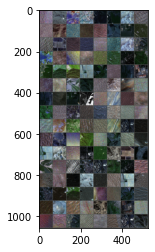

sea land land land land land land sea sea land land sea sea land land land sea land sea sea sea land land land land sea sea sea sea land land land land land land land land sea land land sea sea land land sea land sea sea land sea land land sea land sea sea land sea land sea land land sea sea sea land land sea sea land land sea sea land sea land sea land sea sea land land sea land sea land land land land sea sea land land land land sea sea sea sea land sea sea land sea land sea land sea sea sea land sea sea land sea sea land land land sea sea land land sea sea sea land land


In [6]:
import matplotlib.pyplot as plt
import numpy as np

# functions to show an image
def imshow(img):
  un_mean = mean.view(-1, 1, 1)
  un_std = std.view(-1, 1, 1)
  img = img * un_std + un_mean   # unnormalize
  npimg = img.numpy()
  plt.imshow(np.transpose(npimg, (1, 2, 0)))
  # nuumpy uses H*W*C, while the pytorch uses C*H*W
  plt.show()


# get some random training images
dataiter = iter(trainloader)
images, labels = dataiter.next()
print("image_size:",images.shape)

# show images
imshow(torchvision.utils.make_grid(images))
# print labels
print(' '.join('%3s' % trainsset.classes[labels[j]] for j in range(batch_size)))

In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Assuming that we are on a CUDA machine, this should print a CUDA device:

print(device)

cuda:0


In [ ]:
import torch.nn as nn
import torch.nn.functional as F


class BasicBlock(nn.Module):
    expansion = 1

    def __init__(self, in_planes, planes, stride=1):
        super(BasicBlock, self).__init__()
        self.conv1 = nn.Conv2d(in_planes, planes, kernel_size=3, stride=stride, padding=1, bias=False)
        self.bn1 = nn.BatchNorm2d(planes)
        self.conv2 = nn.Conv2d(planes, planes, kernel_size=3, stride=1, padding=1, bias=False)
        self.bn2 = nn.BatchNorm2d(planes)

        self.shortcut = nn.Sequential()
        if stride != 1 or in_planes != self.expansion*planes:
            self.shortcut = nn.Sequential(nn.Conv2d(in_planes, self.expansion*planes,
                         kernel_size=1, stride=stride, bias=False),
                nn.BatchNorm2d(self.expansion*planes) )

    def forward(self, x):
        out = F.relu(self.bn1(self.conv1(x)))
        out = self.bn2(self.conv2(out))
        out += self.shortcut(x)
        out = F.relu(out)
        return out


class Bottleneck(nn.Module):
    expansion = 4

    def __init__(self, in_planes, planes, stride=1):
        super(Bottleneck, self).__init__()
        self.conv1 = nn.Conv2d(in_planes, planes, kernel_size=1, bias=False)
        self.bn1 = nn.BatchNorm2d(planes)
        self.conv2 = nn.Conv2d(planes, planes, kernel_size=3, stride=stride, padding=1, bias=False)
        self.bn2 = nn.BatchNorm2d(planes)
        self.conv3 = nn.Conv2d(planes, self.expansion*planes, kernel_size=1, bias=False)
        self.bn3 = nn.BatchNorm2d(self.expansion*planes)

        self.shortcut = nn.Sequential()
        if stride != 1 or in_planes != self.expansion*planes:
            self.shortcut = nn.Sequential(nn.Conv2d(in_planes, self.expansion*planes,
                          kernel_size=1, stride=stride, bias=False),
                nn.BatchNorm2d(self.expansion*planes) )

    def forward(self, x):
        out = F.relu(self.bn1(self.conv1(x)))
        out = F.relu(self.bn2(self.conv2(out)))
        out = self.bn3(self.conv3(out))
        out += self.shortcut(x)
        out = F.relu(out)
        return out


class ResNet(nn.Module):
    def __init__(self, block, num_blocks, num_classes=10):
        super(ResNet, self).__init__()
        self.in_planes = 64

        self.conv1 = nn.Conv2d(3, 64, kernel_size=3, stride=1, padding=1, bias=False)
        self.bn1 = nn.BatchNorm2d(64)
        self.layer1 = self._make_layer(block, 64, num_blocks[0], stride=1)
        self.layer2 = self._make_layer(block, 128, num_blocks[1], stride=2)
        self.layer3 = self._make_layer(block, 256, num_blocks[2], stride=2)
        self.layer4 = self._make_layer(block, 512, num_blocks[3], stride=2)
        self.inplanes = 1024
        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))
        self.linear = nn.Linear(512*block.expansion, num_classes)

    def _make_layer(self, block, planes, num_blocks, stride):
        strides = [stride] + [1]*(num_blocks-1)
        layers = []
        for stride in strides:
            layers.append(block(self.in_planes, planes, stride))
            self.in_planes = planes * block.expansion
        return nn.Sequential(*layers)

    def forward(self, x):
        out = F.relu(self.bn1(self.conv1(x)))
        out = self.layer1(out)
        out = self.layer2(out)
        out = self.layer3(out)
        out = self.layer4(out)
        out = self.avgpool(out)
        out = out.view(out.size(0), -1)
        out = self.linear(out)

        return out


def ResNet18():
    return ResNet(BasicBlock, [2, 2, 2, 2])

def ResNet34():
    return ResNet(BasicBlock, [3, 4, 6, 3])


net = ResNet18().to(device)

In [ ]:
import torch.optim as optim
import torch.optim.lr_scheduler as lr_scheduler

criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(net.parameters(), lr=0.001, momentum=0.9, weight_decay=1e-4)
lr_scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, 52, eta_min=0.0001)

# stochastic gradient descent 

In [ ]:
def draw_result(lst_iter, train, valid, title):
    plt.plot(lst_iter, train, '-b', label='train set')
    plt.plot(lst_iter, valid, '-r', label='validation set')

    plt.xlabel("n epoch")
    plt.legend(loc='upper left')
    plt.title(title)

    # show
    plt.show()

In [ ]:
PATH = './drive/MyDrive/sea_land_RN18_64.pth'

[epoch 1] accuracy: 83.367, loss: 0.494
Accuracy of the network on the validation set: 90.800, loss: 0.206
[epoch 2] accuracy: 93.800, loss: 0.165
Accuracy of the network on the validation set: 93.200, loss: 0.202
[epoch 3] accuracy: 96.000, loss: 0.107
Accuracy of the network on the validation set: 96.750, loss: 0.084
[epoch 4] accuracy: 97.400, loss: 0.076
Accuracy of the network on the validation set: 97.200, loss: 0.081
[epoch 5] accuracy: 98.400, loss: 0.051
Accuracy of the network on the validation set: 97.450, loss: 0.060
[epoch 6] accuracy: 98.717, loss: 0.041
Accuracy of the network on the validation set: 92.900, loss: 0.237
[epoch 7] accuracy: 98.967, loss: 0.031
Accuracy of the network on the validation set: 94.900, loss: 0.114
[epoch 8] accuracy: 99.250, loss: 0.024
Accuracy of the network on the validation set: 97.650, loss: 0.059
[epoch 9] accuracy: 99.417, loss: 0.021
Accuracy of the network on the validation set: 97.550, loss: 0.062
[epoch 10] accuracy: 99.800, loss: 0.

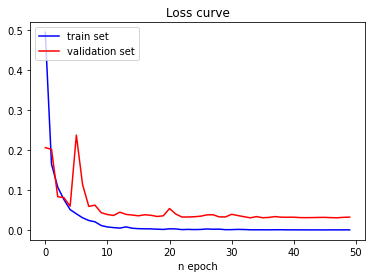

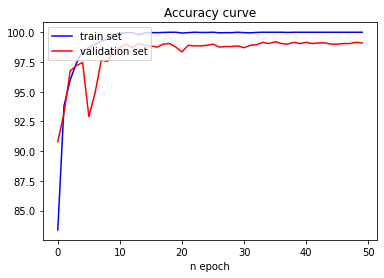

In [ ]:
best_val_acc = -1000
epoch_num = 50
train_loss_np = []
train_acc_np = []
valid_loss_np = []
valid_acc_np = []

for epoch in range(epoch_num):  # loop over the dataset multiple times
    
    net.train()
    running_loss = 0.0
    running_correct = 0
    running_total = 0 

    ####### training set #######
    for i, data in enumerate(trainloader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = net(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()  # update

        # print statistics
        running_loss += loss.item()*inputs.size(0)
        _, predicted = torch.max(outputs.data, 1)
        running_total += labels.size(0)
        running_correct += (predicted == labels).sum().item()
    train_loss = running_loss/len(trainset)
    train_acc = 100*running_correct/len(trainset)
    print('[epoch %d] accuracy: %.3f, loss: %.3f' %
                  (epoch + 1, train_acc, train_loss))     
    train_loss_np.append(train_loss)
    train_acc_np.append(train_acc)


    ####### validation set #######
    net.eval()
    valiloss = 0
    correct = 0
    total = 0
    # since we're not training, we don't need to calculate the gradients for our outputs
    with torch.no_grad():
        for data in validloader:
            images, labels = data
            images = images.to(device)
            labels = labels.to(device)
            # calculate outputs by running images through the network
            outputs = net(images)
            loss = criterion(outputs, labels)
            valiloss += loss.item()*inputs.size(0)
            # the class with the highest energy is what we choose as prediction
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    valid_loss = valiloss/len(validset)
    valid_acc = 100*correct/len(validset)
    print('Accuracy of the network on the validation set: %.3f, loss: %.3f' % (
                     valid_acc, valid_loss))
        
    valid_loss_np.append(valid_loss)
    valid_acc_np.append(valid_acc)    


    if correct>best_val_acc:
        best_val_acc = correct
        torch.save(net.state_dict(), PATH)
    lr_scheduler.step() 
print('Finished Training')

draw_result(range(epoch_num), train_loss_np, valid_loss_np, 'Loss curve')
draw_result(range(epoch_num), train_acc_np, valid_acc_np, 'Accuracy curve')

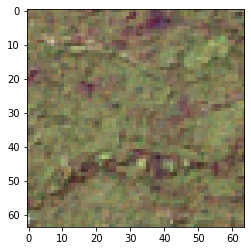

Predicted: 1   sea   GroundTruth:  land


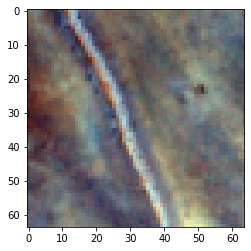

Predicted: 1   sea   GroundTruth:  land


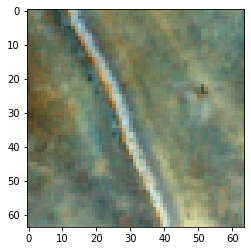

Predicted: 1   sea   GroundTruth:  land


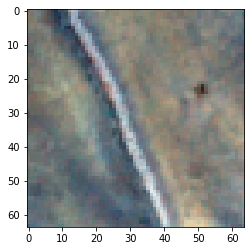

Predicted: 1   sea   GroundTruth:  land


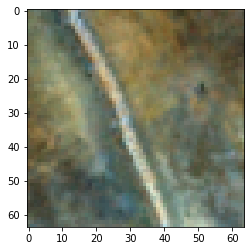

Predicted: 1   sea   GroundTruth:  land


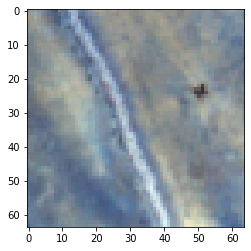

Predicted: 1   sea   GroundTruth:  land


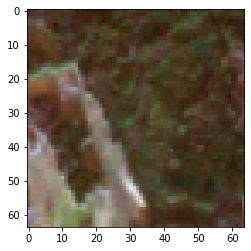

Predicted: 1   sea   GroundTruth:  land


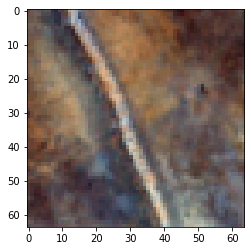

Predicted: 1   sea   GroundTruth:  land


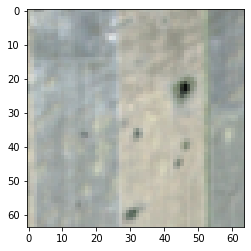

Predicted: 1   sea   GroundTruth:  land


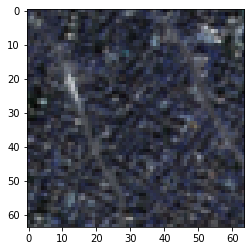

Predicted: 1   sea   GroundTruth:  land


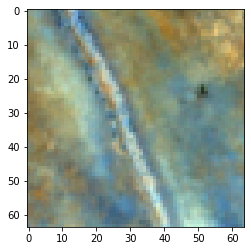

Predicted: 1   sea   GroundTruth:  land


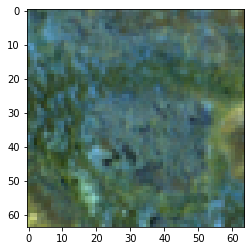

Predicted: 1   sea   GroundTruth:  land


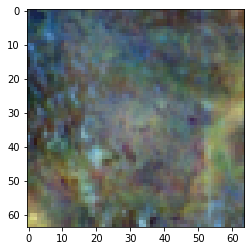

Predicted: 1   sea   GroundTruth:  land


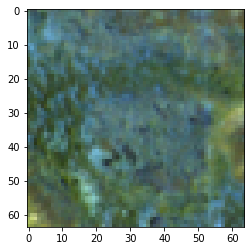

Predicted: 1   sea   GroundTruth:  land


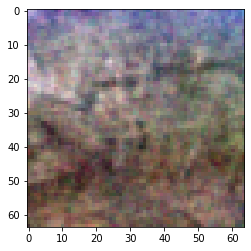

Predicted: 1   sea   GroundTruth:  land


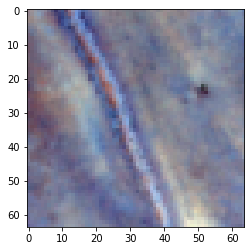

Predicted: 1   sea   GroundTruth:  land


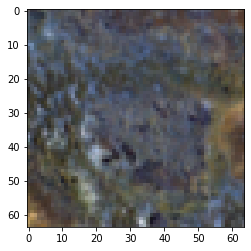

Predicted: 1   sea   GroundTruth:  land


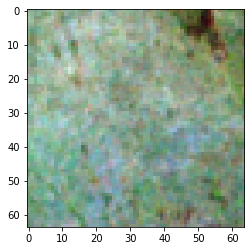

Predicted: 1   sea   GroundTruth:  land


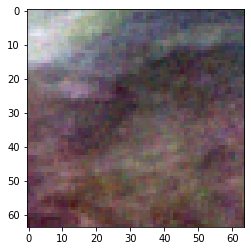

Predicted: 1   sea   GroundTruth:  land


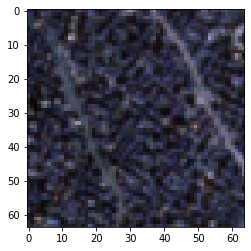

Predicted: 1   sea   GroundTruth:  land


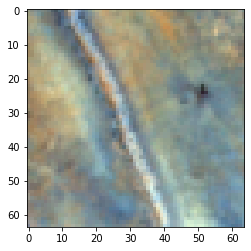

Predicted: 1   sea   GroundTruth:  land


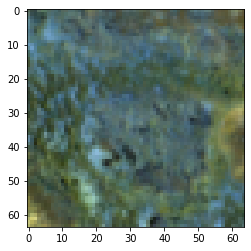

Predicted: 1   sea   GroundTruth:  land


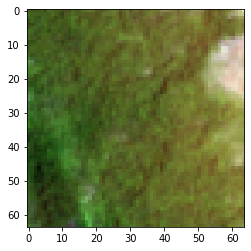

Predicted: 1   sea   GroundTruth:  land


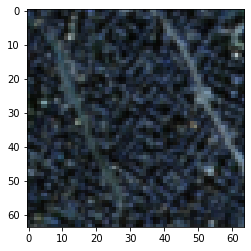

Predicted: 1   sea   GroundTruth:  land


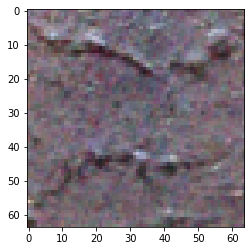

Predicted: 1   sea   GroundTruth:  land


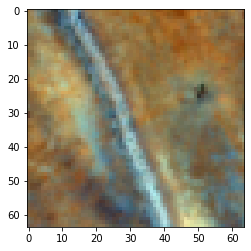

Predicted: 1   sea   GroundTruth:  land


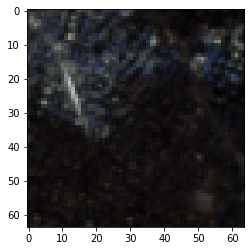

Predicted: 1   sea   GroundTruth:  land


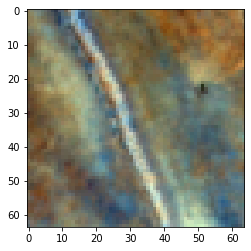

Predicted: 1   sea   GroundTruth:  land


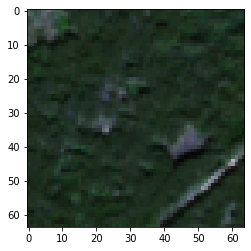

Predicted: 1   sea   GroundTruth:  land


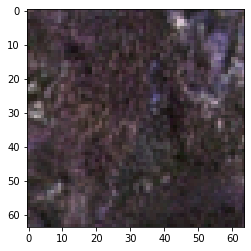

Predicted: 1   sea   GroundTruth:  land


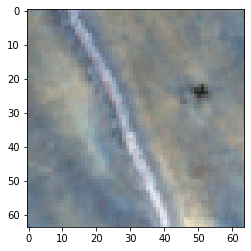

Predicted: 1   sea   GroundTruth:  land


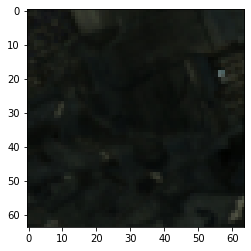

Predicted: 1   sea   GroundTruth:  land


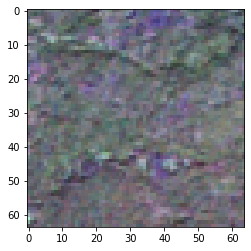

Predicted: 1   sea   GroundTruth:  land


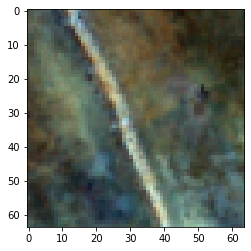

Predicted: 1   sea   GroundTruth:  land


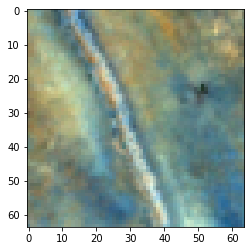

Predicted: 1   sea   GroundTruth:  land


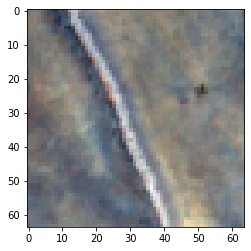

Predicted: 1   sea   GroundTruth:  land


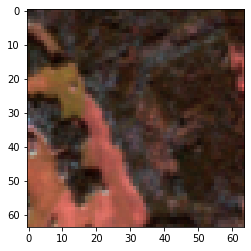

Predicted: 1   sea   GroundTruth:  land


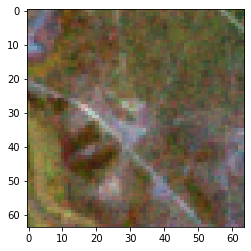

Predicted: 1   sea   GroundTruth:  land


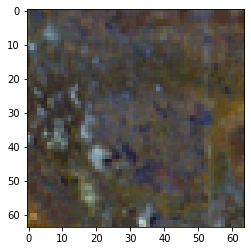

Predicted: 1   sea   GroundTruth:  land


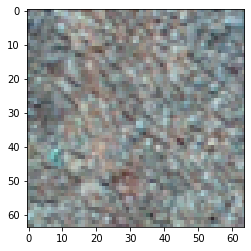

Predicted: 1   sea   GroundTruth:  land


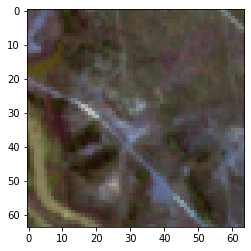

Predicted: 1   sea   GroundTruth:  land


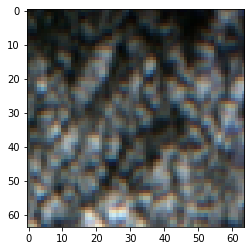

Predicted: 1   sea   GroundTruth:  land


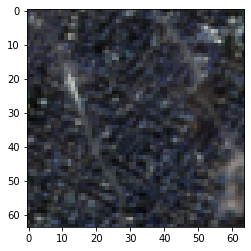

Predicted: 1   sea   GroundTruth:  land


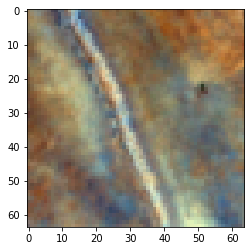

Predicted: 1   sea   GroundTruth:  land


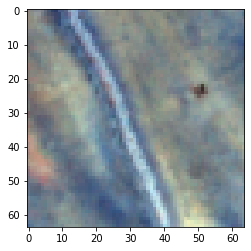

Predicted: 1   sea   GroundTruth:  land


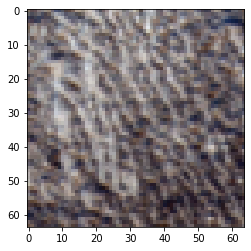

Predicted: 1   sea   GroundTruth:  land


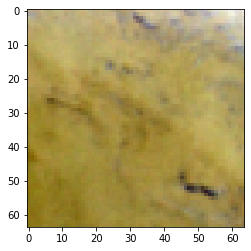

Predicted: 1   sea   GroundTruth:  land


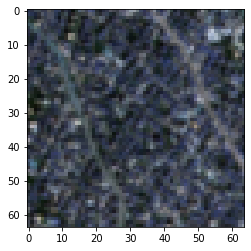

Predicted: 1   sea   GroundTruth:  land


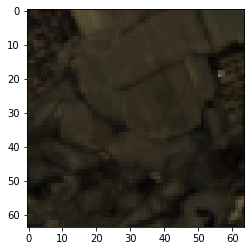

Predicted: 1   sea   GroundTruth:  land


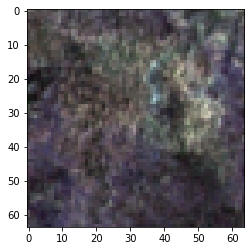

Predicted: 1   sea   GroundTruth:  land


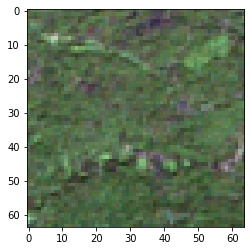

Predicted: 1   sea   GroundTruth:  land


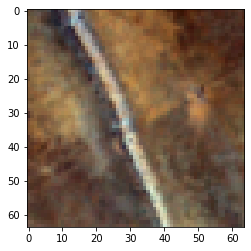

Predicted: 1   sea   GroundTruth:  land


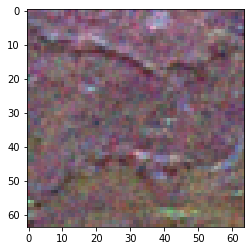

Predicted: 1   sea   GroundTruth:  land


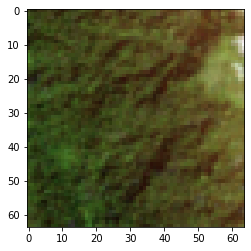

Predicted: 1   sea   GroundTruth:  land


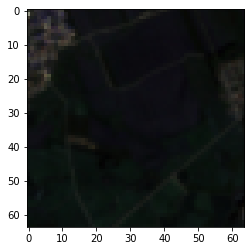

Predicted: 1   sea   GroundTruth:  land


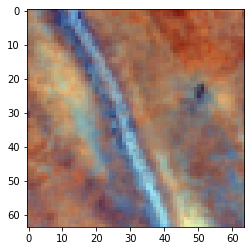

Predicted: 1   sea   GroundTruth:  land


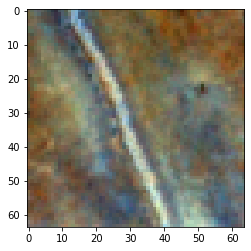

Predicted: 1   sea   GroundTruth:  land


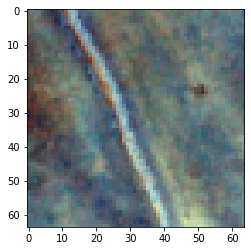

Predicted: 1   sea   GroundTruth:  land


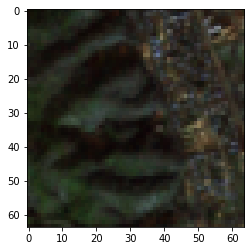

Predicted: 1   sea   GroundTruth:  land


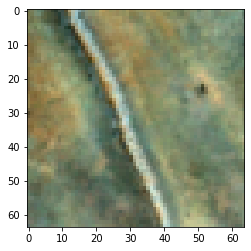

Predicted: 1   sea   GroundTruth:  land


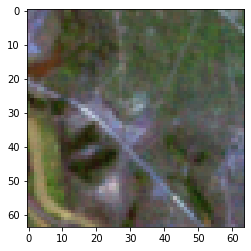

Predicted: 1   sea   GroundTruth:  land


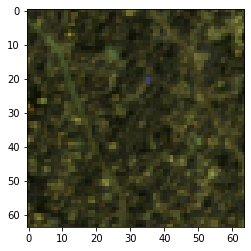

Predicted: 1   sea   GroundTruth:  land


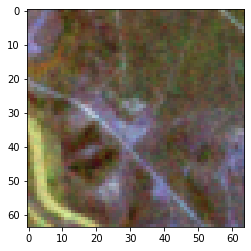

Predicted: 1   sea   GroundTruth:  land


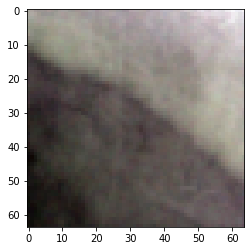

Predicted: 1   sea   GroundTruth:  land


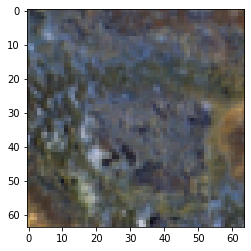

Predicted: 1   sea   GroundTruth:  land


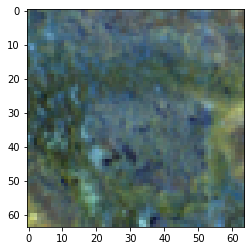

Predicted: 1   sea   GroundTruth:  land


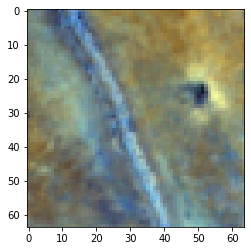

Predicted: 1   sea   GroundTruth:  land


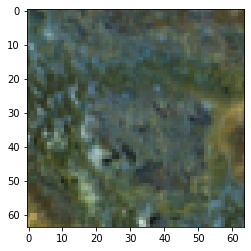

Predicted: 1   sea   GroundTruth:  land


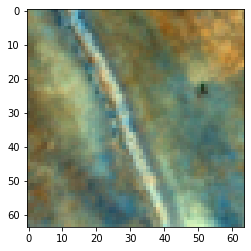

Predicted: 1   sea   GroundTruth:  land


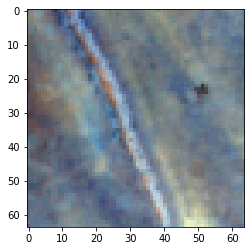

Predicted: 1   sea   GroundTruth:  land


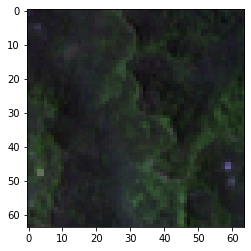

Predicted: 1   sea   GroundTruth:  land


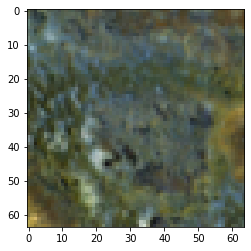

Predicted: 1   sea   GroundTruth:  land


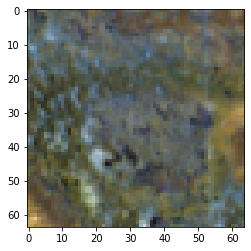

Predicted: 1   sea   GroundTruth:  land


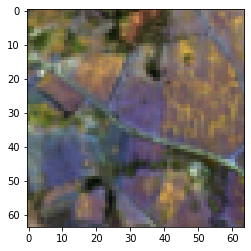

Predicted: 1   sea   GroundTruth:  land


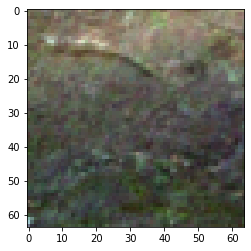

Predicted: 1   sea   GroundTruth:  land


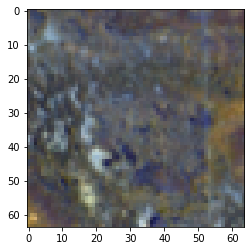

Predicted: 1   sea   GroundTruth:  land


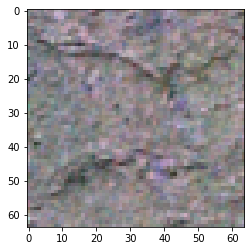

Predicted: 1   sea   GroundTruth:  land


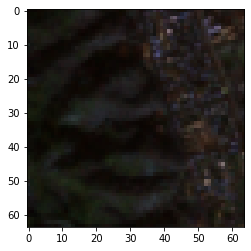

Predicted: 1   sea   GroundTruth:  land


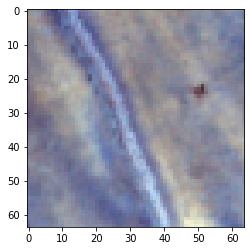

Predicted: 1   sea   GroundTruth:  land


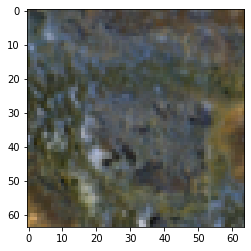

Predicted: 1   sea   GroundTruth:  land


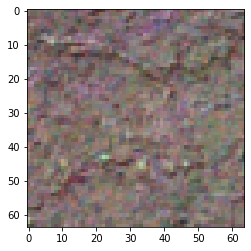

Predicted: 1   sea   GroundTruth:  land


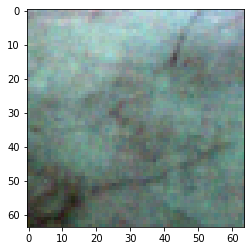

Predicted: 1   sea   GroundTruth:  land


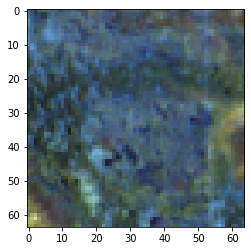

Predicted: 1   sea   GroundTruth:  land


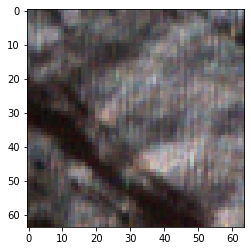

Predicted: 0  land   GroundTruth:   sea


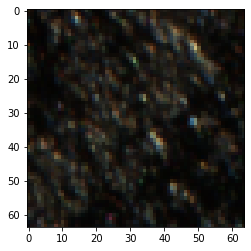

Predicted: 0  land   GroundTruth:   sea


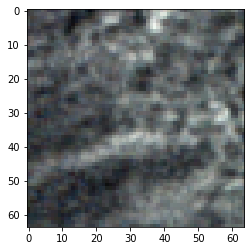

Predicted: 0  land   GroundTruth:   sea


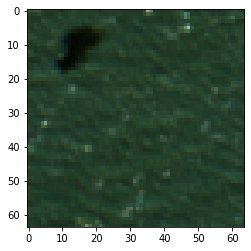

Predicted: 0  land   GroundTruth:   sea


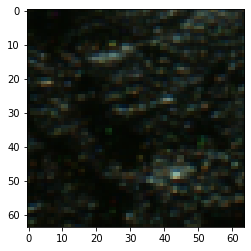

Predicted: 0  land   GroundTruth:   sea


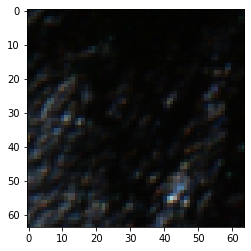

Predicted: 0  land   GroundTruth:   sea


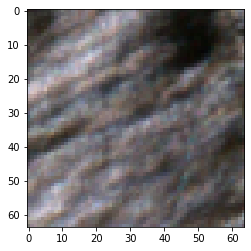

Predicted: 0  land   GroundTruth:   sea


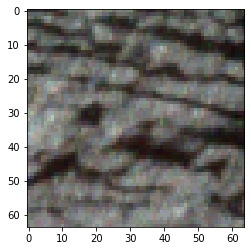

Predicted: 0  land   GroundTruth:   sea


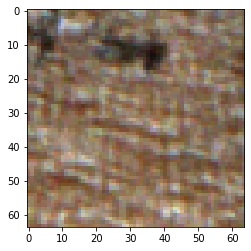

Predicted: 0  land   GroundTruth:   sea


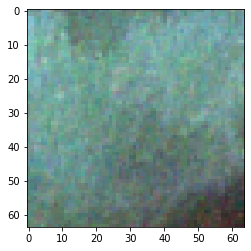

Predicted: 0  land   GroundTruth:   sea


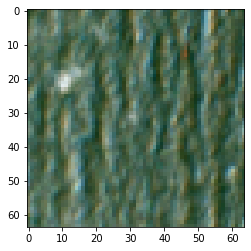

Predicted: 0  land   GroundTruth:   sea


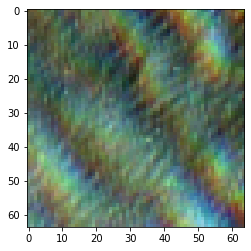

Predicted: 0  land   GroundTruth:   sea


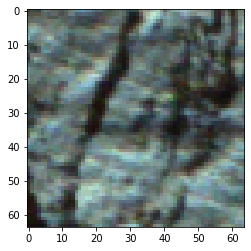

Predicted: 0  land   GroundTruth:   sea
Accuracy of the network on the 2000 test images: 95.200 %


In [ ]:
correct = 0
total = 0
net.load_state_dict(torch.load(PATH))
classes = testset.classes
net.eval()
# since we're not training, we don't need to calculate the gradients for our outputs
with torch.no_grad():
    for data in testloader:
        k = 1
        images, labels = data
        images = images.to(device)
        labels = labels.to(device)
        # calculate outputs by running images through the network
        outputs = net(images)
        # the class with the highest energy is what we choose as prediction
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()
        for i in range(len(images)):
          if classes[predicted[i]] != classes[labels[i]]:
            w_images = images[i].cpu()
            imshow(w_images)
            print('Predicted:', predicted[i].cpu().numpy(), ''.join('%5s' % classes[predicted[i]] ),'  GroundTruth:',''.join('%5s' % classes[labels[i]]))
print('Accuracy of the network on the 2000 test images: %.3f %%' % (
    100 * correct / total))

Load an image containing a coastline

In [ ]:
!pip install geetools
!pip install --upgrade geetools

In [ ]:
import geetools

bands = ['B2', 'B3', 'B4']
rec = ee.Geometry.Rectangle([-1.534, 55.085, -1.465, 55.164])

# Load Sentinel-2 TOA reflectance data
# Pre-filter to get less cloudy granules.
test_image = (ee.ImageCollection('COPERNICUS/S2')
       .filterBounds(rec)
       .filterDate('2021-04-19', '2021-04-20')  
       .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE', 20))
       .select(bands)).limit(1)

# Set parameters
scale = 10
name_pattern = 'UK_north_{system_date}'
## the keywords between curly brackets can be {system_date} for the date of the
## image (formatted using `date_pattern` arg), {id} for the id of the image
## and/or any image property. You can also pass extra keywords using the `extra`
## argument. Also, numeric values can be formatted using a format string (as
## shown in {WRS_PATH:%d} (%d means it will be converted to integer)
date_pattern = 'ddMMMy' # dd: day, MMM: month (JAN), y: year
folder = 'im'
data_type = 'uint32'
region = rec

# ## Export
tasks = geetools.batch.Export.imagecollection.toDrive(
            collection=test_image,
            folder=folder,
            namePattern=name_pattern,
            region=rec,
            scale=scale,
            dataType=data_type,
            datePattern=date_pattern,
            maxPixels=1e9,
            verbose=True,
        )

exporting UK_north_19Apr2021 to folder 'im' in GDrive


In [ ]:
!pip install rasterio
!pip install imagecodecs

imread_image.shape (3, 1818, 2146)
imread_image.dtype uint32
[[[1186 1183 1168 ... 1140 1141 1148]
  [1295 1246 1215 ... 1146 1134 1145]
  [1264 1267 1257 ... 1148 1140 1136]
  ...
  [1355 1363 1356 ...  983  982  997]
  [1328 1359 1372 ...  983  974  992]
  [1315 1348 1394 ...  984  989  984]]

 [[1100 1126 1108 ...  883  883  901]
  [1192 1122 1057 ...  877  872  894]
  [1254 1240 1227 ...  880  883  898]
  ...
  [1204 1228 1242 ...  711  711  719]
  [1205 1223 1238 ...  723  710  717]
  [1204 1218 1251 ...  713  707  715]]

 [[1079 1086 1039 ...  494  486  486]
  [1264 1128 1038 ...  489  490  488]
  [1323 1293 1259 ...  482  493  491]
  ...
  [1166 1172 1231 ...  387  383  382]
  [1115 1170 1244 ...  390  378  382]
  [1098 1166 1240 ...  391  382  383]]]
(1818, 2146, 3)


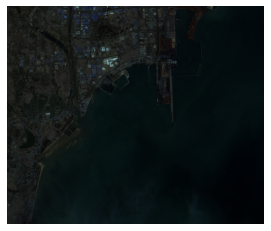

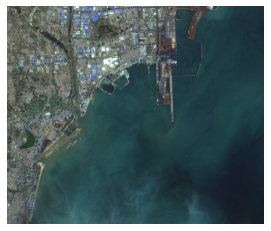

In [ ]:
import imagecodecs
import os
import rasterio as rio
import tifffile
import matplotlib.pyplot as plt
from rasterio.plot import show
import numpy as np
from PIL import Image
import cv2

# Open and read the raster data
raster_path = os.path.join('/content/drive/MyDrive/im', 'China_Qingdao_06Apr2021.tif')

# Open and read the raster data
with rio.open(raster_path, 'r') as sen_raster:
  sen_data = sen_raster.read()
print("imread_image.shape", sen_data.shape) 
print("imread_image.dtype", sen_data.dtype)
print(sen_data)

# Function to normalize the grid values
def normalize(array):
    """Normalizes numpy arrays into scale 0.0 - 1.0"""
    array_min, array_max = array.min(), array.max()
    return ((array - array_min)/(array_max - array_min))
 
# To plot as RGB we have to normalize the data
sen_image = np.empty(sen_data.shape, dtype=np.uint8)
for band in range (sen_data.shape[0]):
  sen_image[band] = 255*normalize(sen_data[band])

s_im = sen_image[[2,1,0],:,:]
sen_image = np.transpose(s_im, (1,2,0))
print(sen_image.shape)
plt.imshow(sen_image)
plt.axis('off')
plt.show()

alpha = 3 # Contrast control (1.0-3.0)
beta = 20 # Brightness control (0-100)

adjusted = cv2.convertScaleAbs(sen_image, alpha=alpha, beta=beta)
plt.imshow(adjusted)
plt.axis('off')
plt.show()

Block division

In [ ]:
# Image division
def TifCroppingArray(img, RepetitiveLength, sidelength):
    TifArrayReturn = []
    # total number of columns
    ColumnNum = int((img.shape[0] - RepetitiveLength * 2) / (sidelength - RepetitiveLength * 2))
    # total number of rows
    RowNum = int((img.shape[1] - RepetitiveLength * 2) / (sidelength - RepetitiveLength * 2))
    for i in range(ColumnNum):
        TifArray = []
        for j in range(RowNum):
            cropped = img[i * (sidelength - RepetitiveLength * 2) : i * (sidelength - RepetitiveLength * 2) + sidelength,
                          j * (sidelength - RepetitiveLength * 2) : j * (sidelength - RepetitiveLength * 2) + sidelength]
            TifArray.append(cropped)
        TifArrayReturn.append(TifArray)
    # consider last column and row
    # divide the last column from the opposite direction
    for i in range(ColumnNum):
        cropped = img[i * (sidelength - RepetitiveLength * 2) : i * (sidelength - RepetitiveLength * 2) + sidelength,
                      (img.shape[1] - sidelength) : img.shape[1]]
        TifArrayReturn[i].append(cropped)
    #  divide the last row from the opposite direction
    TifArray = []
    for j in range(RowNum):
        cropped = img[(img.shape[0] - sidelength) : img.shape[0],
                      j * (sidelength-RepetitiveLength*2) : j * (sidelength - RepetitiveLength * 2) + sidelength]
        TifArray.append(cropped)
    # bottom right cornor
    cropped = img[(img.shape[0] - sidelength) : img.shape[0],
                  (img.shape[1] - sidelength) : img.shape[1]]
    TifArray.append(cropped)
    TifArrayReturn.append(TifArray)
    # left pixels in column
    ColumnOver = (img.shape[0] - RepetitiveLength * 2) % (sidelength - RepetitiveLength * 2) + RepetitiveLength
    # left pixels in row
    RowOver = (img.shape[1] - RepetitiveLength * 2) % (sidelength - RepetitiveLength * 2) + RepetitiveLength
    return TifArrayReturn, RowOver, ColumnOver

In [ ]:
import math

area_perc = 0.5
crop_length = 64
RepetitiveLength = int((1 - math.sqrt(area_perc)) * crop_length / 2)

TifArrayReturn, RowOver, ColumnOver = TifCroppingArray(adjusted, RepetitiveLength, crop_length)
TifArrayReturn

[[array([[[ 77,  80,  68],
          [ 77,  83,  68],
          [ 74,  80,  65],
          ...,
          [131, 122,  98],
          [113, 116,  98],
          [128, 128, 107]],
  
         [[ 92,  92,  86],
          [ 80,  83,  77],
          [ 74,  74,  74],
          ...,
          [131, 131,  98],
          [116, 119, 107],
          [128, 128, 107]],
  
         [[ 95, 101,  80],
          [ 92,  98,  83],
          [ 89,  98,  80],
          ...,
          [116, 116,  95],
          [119, 116, 104],
          [128, 131, 104]],
  
         ...,
  
         [[ 59,  68,  56],
          [ 77,  86,  74],
          [113, 110,  89],
          ...,
          [128, 128, 107],
          [125, 125, 104],
          [116, 110,  98]],
  
         [[ 62,  71,  62],
          [ 80,  86,  71],
          [119, 116,  95],
          ...,
          [143, 143, 116],
          [140, 134, 110],
          [134, 119, 104]],
  
         [[ 65,  68,  59],
          [ 83,  89,  77],
          [125, 119, 101

In [ ]:
t = TifArrayReturn[0]
t[0].shape


(64, 64, 3)

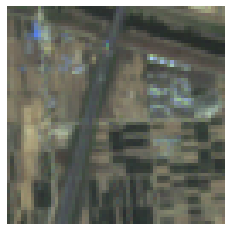

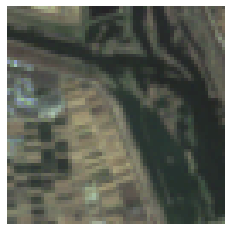

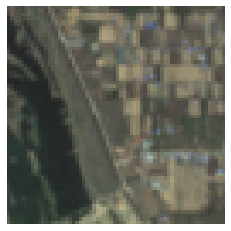

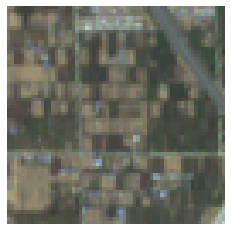

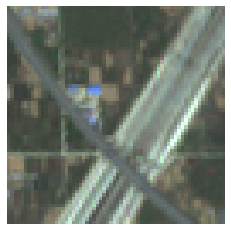

...

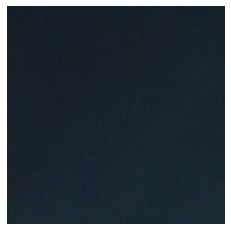

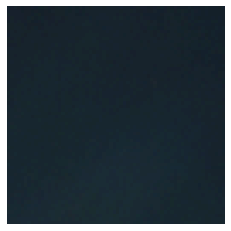

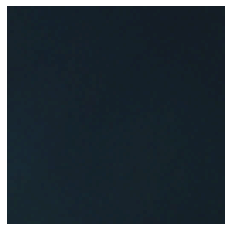

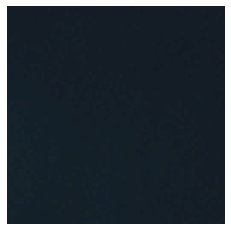

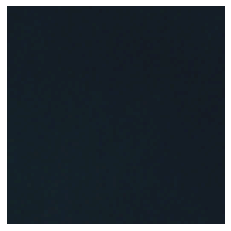

In [ ]:
# show image blocks
total_list = []

for i in range(len(TifArrayReturn)):
  for j in range(len(TifArrayReturn[0])):
    im = TifArrayReturn[i][j]
    plt.imshow(im)
    plt.axis('off')
    plt.show()
    total_list.append(im)
#print(total_list)

Create MyDataset for predict image blocks

In [ ]:
import torch
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
import numpy as np
from PIL import Image


class MyDataset(Dataset):
    def __init__(self, data, transform=None):
        self.data = data
        self.transform = transform
        
    def __getitem__(self, index):
        x = self.data[index]
        
        if self.transform:
            x = Image.fromarray(self.data[index])
            x = self.transform(x)
        
        return x,
    def __len__(self):
        return len(self.data)

transform = transforms.Compose([transforms.Resize(64), transforms.ToTensor()])
dataset = MyDataset(total_list, transform=transform)
dataloader = DataLoader(dataset, batch_size=32)

In [ ]:
net.load_state_dict(torch.load(PATH))
net.eval()
x_pred_list = []
# since we're not training, we don't need to calculate the gradients for our outputs
with torch.no_grad():
    for data in dataloader:
        images, = data
        images = images.to(device)
        # calculate outputs by running images through the network
        outputs = net(images)
        # the class with the highest energy is what we choose as prediction
        _, predicted = torch.max(outputs.data, 1)  
        x_pred_list.append(predicted.cpu().numpy())
print('Finish testing.')

Finish testing.


In [ ]:
# '1': sea; '0': land
x_pred_list

[array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 1]),
 array([1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0]),
 array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 0, 0]),
 array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 1, 1, 1, 1]),
 array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 1, 1]),
 array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 0, 0, 0, 0]),
 array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0,
        0, 1, 0, 0, 1, 1, 1, 1, 1, 1]),
 array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0]),
 array([0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 

create masks

In [ ]:
# black: land; white: sea
black_array = np.zeros((len(TifArrayReturn[0][0]), len(TifArrayReturn[0][0])))
white_array = np.ones((len(TifArrayReturn[0][0]), len(TifArrayReturn[0][0])))
res_list = []

for i in range(len(x_pred_list)):
  for j in x_pred_list[i]:
    if j == 0:
      res_list.append(black_array)
    else:
      res_list.append(white_array)

print(res_list)
print(len(res_list))

[array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]]), array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]]), array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]]), array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]]), array([[0., 0., 0., ..., 0., 0.

In [ ]:
# reshape 
res_reshape = []

for i in range(len(TifArrayReturn)):
  line_arr = []
  for j in range(len(TifArrayReturn[0])):
    index = j+i*len(TifArrayReturn[0])
    line_arr.append(res_list[index])
  res_reshape.append(line_arr)


block stitching

In [ ]:
def Result(shape, Array1, RepetitiveLength, Sidelength, RowOver, ColumnOver):
    result = np.zeros(shape, np.uint8) 
    for k, TifArray in enumerate(Array1):
      for i, item in enumerate(TifArray):
        img = item
        # the first column from the left
        if(i == 0):
          # consider the first row
          if(k == 0):
              result[0 : Sidelength - RepetitiveLength, 0 : Sidelength - RepetitiveLength] = img[0 : Sidelength - RepetitiveLength, 0 : Sidelength - RepetitiveLength]
          # consider the last row
          elif(k == len(Array1) - 1):
            result[shape[0] - ColumnOver - RepetitiveLength: shape[0], 0 : Sidelength - RepetitiveLength] = img[Sidelength - ColumnOver - RepetitiveLength : Sidelength, 0 : Sidelength - RepetitiveLength]
          else:
            result[k * (Sidelength - 2 * RepetitiveLength) + RepetitiveLength : (k + 1) * (Sidelength - 2 * RepetitiveLength) + RepetitiveLength,
                0 : Sidelength - RepetitiveLength] = img[RepetitiveLength : Sidelength - RepetitiveLength, 0 : Sidelength - RepetitiveLength]   
        #  the first column from right
        elif(i == len(TifArray) - 1):
            # consider the first column
          if(k == 0):
              result[0 : Sidelength - RepetitiveLength, shape[1] - RowOver: shape[1]] = img[0 : Sidelength - RepetitiveLength, Sidelength -  RowOver: Sidelength]
          # consider the last row
          elif(k == len(Array1) - 1):
                result[shape[0] - ColumnOver : shape[0], shape[1] - RowOver : shape[1]] = img[Sidelength - ColumnOver : Sidelength, Sidelength - RowOver : Sidelength]
          else:
            result[k * (Sidelength - 2 * RepetitiveLength) + RepetitiveLength : (k + 1) * (Sidelength - 2 * RepetitiveLength) + RepetitiveLength,
                    shape[1] - RowOver : shape[1]] = img[RepetitiveLength : Sidelength - RepetitiveLength, Sidelength - RowOver : Sidelength]   
        else:
          # consider the first row
          if(k == 0):
            result[0 : Sidelength - RepetitiveLength,
                    i * (Sidelength - 2 * RepetitiveLength) + RepetitiveLength : (i+1) * (Sidelength - 2 * RepetitiveLength) + RepetitiveLength
                    ] = img[0 : Sidelength - RepetitiveLength, RepetitiveLength : Sidelength - RepetitiveLength]         
          # consider the last row
          if(k == len(Array1) - 1):
            result[shape[0] - ColumnOver : shape[0], i * (Sidelength - 2 * RepetitiveLength) + RepetitiveLength : 
                   (i+1) * (Sidelength - 2 * RepetitiveLength) + RepetitiveLength
                   ] = img[Sidelength - ColumnOver : Sidelength, RepetitiveLength : Sidelength - RepetitiveLength]
          else:
            result[k * (Sidelength - 2 * RepetitiveLength) + RepetitiveLength : (k + 1) * (Sidelength - 2 * RepetitiveLength) + RepetitiveLength,
                   i * (Sidelength - 2 * RepetitiveLength) + RepetitiveLength : (i+1) * (Sidelength - 2 * RepetitiveLength) + RepetitiveLength,
                   ] = img[RepetitiveLength : Sidelength - RepetitiveLength, RepetitiveLength : Sidelength - RepetitiveLength]
    return result

In [ ]:
# final results
result_shape = (adjusted.shape[0], adjusted.shape[1])
result_data = Result(result_shape, res_reshape, RepetitiveLength, crop_length, RowOver, ColumnOver)

In [ ]:
print(result_data)

[[0 0 0 ... 1 1 1]
 [0 0 0 ... 1 1 1]
 [0 0 0 ... 1 1 1]
 ...
 [0 0 0 ... 1 1 1]
 [0 0 0 ... 1 1 1]
 [0 0 0 ... 1 1 1]]


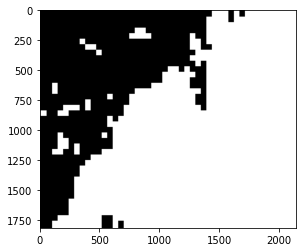

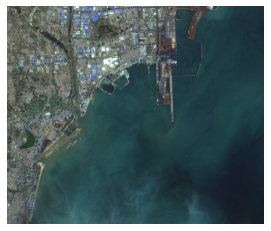

In [ ]:
plt.imshow(result_data,cmap='gray')
plt.show()
plt.imshow(adjusted)
plt.axis('off')
plt.show()

Post-processing based on largest connected area



In [ ]:
def undesired_objects (image):
    image = image.astype('uint8')
    nb_components, output, stats, centroids = cv2.connectedComponentsWithStats(image, connectivity=4)
    sizes = stats[:, -1]

    max_label = 1
    max_size = sizes[1]
    for i in range(2, nb_components):
        if sizes[i] > max_size:
            max_label = i
            max_size = sizes[i]

    img2 = np.zeros(output.shape)
    img2[output == max_label] = 1
    return img2

In [ ]:
filtered_im = undesired_objects(result_data)

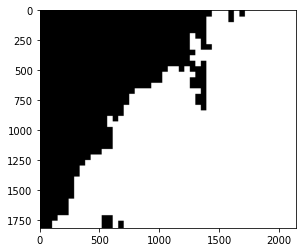

In [ ]:
plt.imshow(filtered_im, cmap='gray')
plt.show()